# Backpack price prediction challenge from kaggle

### Predict the price of backpack

In [2]:
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from plotly.subplots import make_subplots
import plotly.graph_objects as go
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import cross_val_score
import xgboost as xgb
import lightgbm as lgb

In [3]:
df = pd.read_csv("train.csv")
pd.set_option("display.max_columns",None)
df.head()

,id,Brand,Material,Size,Compartments,Laptop Compartment,Waterproof,Style,Color,Weight Capacity (kg),Price
0,0,Jansport,Leather,Medium,7.0,Yes,No,Tote,Black,11.611723,112.15875
1,1,Jansport,Canvas,Small,10.0,Yes,Yes,Messenger,Green,27.078537,68.88056
2,2,Under Armour,Leather,Small,2.0,Yes,No,Messenger,Red,16.643760,39.17320
3,3,Nike,Nylon,Small,8.0,Yes,No,Messenger,Green,12.937220,80.60793
4,4,Adidas,Canvas,Medium,1.0,Yes,Yes,Messenger,Green,17.749338,86.02312


In [4]:
print(f"Number of rows: {df.shape[0]}")
print(f"Number of columns : {df.shape[1]}")

Number of rows: 300000
Number of columns : 11


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 300000 entries, 0 to 299999
Data columns (total 11 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   id                    300000 non-null  int64  
 1   Brand                 290295 non-null  object 
 2   Material              291653 non-null  object 
 3   Size                  293405 non-null  object 
 4   Compartments          300000 non-null  float64
 5   Laptop Compartment    292556 non-null  object 
 6   Waterproof            292950 non-null  object 
 7   Style                 292030 non-null  object 
 8   Color                 290050 non-null  object 
 9   Weight Capacity (kg)  299862 non-null  float64
 10  Price                 300000 non-null  float64
dtypes: float64(3), int64(1), object(7)
memory usage: 25.2+ MB


# Data Preprocessing



In [6]:
df.isnull().sum()

id                         0
Brand                   9705
Material                8347
Size                    6595
Compartments               0
Laptop Compartment      7444
Waterproof              7050
Style                   7970
Color                   9950
Weight Capacity (kg)     138
Price                      0
dtype: int64

#### Handling missing values of brand

In [7]:
df['Brand'].value_counts()

Brand
Adidas          60077
Under Armour    59992
Nike            57336
Puma            56814
Jansport        56076
Name: count, dtype: int64

In [8]:
print("Checking whether brand is related with price")
df.groupby("Brand")["Price"].mean()

Checking whether brand is related with price


Brand
Adidas          80.631060
Jansport        81.791276
Nike            81.319209
Puma            81.448607
Under Armour    81.976311
Name: Price, dtype: float64

In [9]:
print("Checking whether brand is related with material")
pd.crosstab(df['Material'], df['Brand'])

Checking whether brand is related with material


Brand,Adidas,Jansport,Nike,Puma,Under Armour
Material,,,,,
Canvas,13755,12565,13205,12648,13645
Leather,14706,13843,14299,13654,14558
Nylon,13860,13463,13226,13553,14239
Polyester,16103,14661,15035,15395,15883


In [10]:
print("Checking whether brand is related with Color")
pd.crosstab(df['Color'],df['Brand'])

Checking whether brand is related with Color


Brand,Adidas,Jansport,Nike,Puma,Under Armour
Color,,,,,
Black,9368,8629,8833,8691,9339
Blue,9531,9104,9215,9041,9643
Gray,9875,9362,9673,9628,10174
Green,9317,8636,8924,8801,9245
Pink,10431,9760,9796,9805,10228
Red,9596,8771,9055,8872,9385


In [11]:
print("Checking whether brand is related with compartments")
df.groupby("Brand")["Compartments"].mean()

Checking whether brand is related with compartments


Brand
Adidas          5.452336
Jansport        5.438405
Nike            5.459955
Puma            5.433309
Under Armour    5.426290
Name: Compartments, dtype: float64

In [12]:
print("Cheking whether brand is related with laptop compartment")
pd.crosstab(df['Brand'],df['Laptop Compartment'])

Cheking whether brand is related with laptop compartment


Laptop Compartment,No,Yes
Brand,,
Adidas,29073,29505
Jansport,26939,27799
Nike,27478,28541
Puma,27414,27939
Under Armour,28626,29786


In [13]:
print("Checking whether brand is related with weight Capacity (kg)")
df.groupby("Brand")["Weight Capacity (kg)"].mean()

Checking whether brand is related with weight Capacity (kg)


Brand
Adidas          18.079028
Jansport        18.004941
Nike            18.024887
Puma            17.956418
Under Armour    18.110693
Name: Weight Capacity (kg), dtype: float64

In [14]:
print("Checking whether brand is related with water proof")
pd.crosstab(df['Brand'],df['Waterproof'])

Checking whether brand is related with water proof


Waterproof,No,Yes
Brand,,
Adidas,29080,29590
Jansport,27188,27524
Nike,27453,28523
Puma,27495,27939
Under Armour,28878,29688


In [15]:
print("Checking whether brand is related with color")
pd.crosstab(df['Brand'],df['Color'])

Checking whether brand is related with color


Color,Black,Blue,Gray,Green,Pink,Red
Brand,,,,,,
Adidas,9368,9531,9875,9317,10431,9596
Jansport,8629,9104,9362,8636,9760,8771
Nike,8833,9215,9673,8924,9796,9055
Puma,8691,9041,9628,8801,9805,8872
Under Armour,9339,9643,10174,9245,10228,9385


Since no other feature is related with the brand we proportional imputation - to avoid disproportion of brand

In [16]:
brand_distribution = df['Brand'].value_counts(normalize=True)
brand_distribution

Brand
Adidas          0.206952
Under Armour    0.206659
Nike            0.197509
Puma            0.195711
Jansport        0.193169
Name: proportion, dtype: float64

In [17]:
missing_brand_indices = df[df['Brand'].isnull()].index
df.loc[missing_brand_indices,"Brand"] = np.random.choice(brand_distribution.index,size=len(missing_brand_indices),p=brand_distribution.values)

In [18]:
df['Brand'].value_counts(normalize=True) # this shows we almost normalized the bias 

Brand
Adidas          0.207120
Under Armour    0.206477
Nike            0.197467
Puma            0.195600
Jansport        0.193337
Name: proportion, dtype: float64

#### Handling missing values of feature - material

We do proportional imputation 


In [19]:
material_distribution = df['Material'].value_counts(normalize=True)
material_distribution

Material
Polyester    0.273030
Leather      0.251724
Nylon        0.242079
Canvas       0.233167
Name: proportion, dtype: float64

In [20]:
missing_material_indices = df[df['Material'].isnull()].index
df.loc[missing_material_indices,'Material'] = np.random.choice(material_distribution.index,size=len(missing_material_indices),p=material_distribution.values)

#### Handling missing values of size
We do proportion imputation

In [21]:
missing_size = df['Size'].value_counts(normalize=True)
missing_size_indices  = df[df['Size'].isnull()].index
df.loc[missing_size_indices,'Size'] = np.random.choice(missing_size.index,size = len(missing_size_indices),p = missing_size.values)


In [22]:
df.isnull().sum()

id                         0
Brand                      0
Material                   0
Size                       0
Compartments               0
Laptop Compartment      7444
Waterproof              7050
Style                   7970
Color                   9950
Weight Capacity (kg)     138
Price                      0
dtype: int64

#### Handling missing values of Laptop compartments

In [23]:
missing_laptop_compartment = df['Laptop Compartment'].value_counts(normalize=True)
missing_laptop_compartment_indices  = df[df['Laptop Compartment'].isnull()].index
df.loc[missing_laptop_compartment_indices,'Laptop Compartment'] = np.random.choice(missing_laptop_compartment.index,
                                                                                   size = len(missing_laptop_compartment_indices),
                                                                                   p = missing_laptop_compartment.values)

#### Handling missing values of Waterproof

In [24]:
missing_waterproof = df['Waterproof'].value_counts(normalize=True)
missing_waterproof_indices  = df[df['Waterproof'].isnull()].index
df.loc[missing_waterproof_indices,'Waterproof'] = np.random.choice(missing_waterproof.index,
                                                                                   size = len(missing_waterproof_indices),
                                                                                   p = missing_waterproof.values)

#### Handling missing values of Style

In [25]:
df["Style"].fillna(df["Style"].mode()[0], inplace=True)

C:\Users\USER\AppData\Local\Temp\ipykernel_3816\1596473975.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df["Style"].fillna(df["Style"].mode()[0], inplace=True)


#### Handling missing values of Color

In [26]:
df['Color'].fillna(df['Color'].mode()[0],inplace=True)

C:\Users\USER\AppData\Local\Temp\ipykernel_3816\1859550221.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df['Color'].fillna(df['Color'].mode()[0],inplace=True)


#### Handling missing values of weight capacity

In [27]:
df.fillna({'Weight Capacity (kg)':df['Weight Capacity (kg)'].mean()},inplace=True)

In [28]:
df.isnull().sum()

id                      0
Brand                   0
Material                0
Size                    0
Compartments            0
Laptop Compartment      0
Waterproof              0
Style                   0
Color                   0
Weight Capacity (kg)    0
Price                   0
dtype: int64

Checking for outliers

c:\Users\USER\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\categorical.py:632: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)


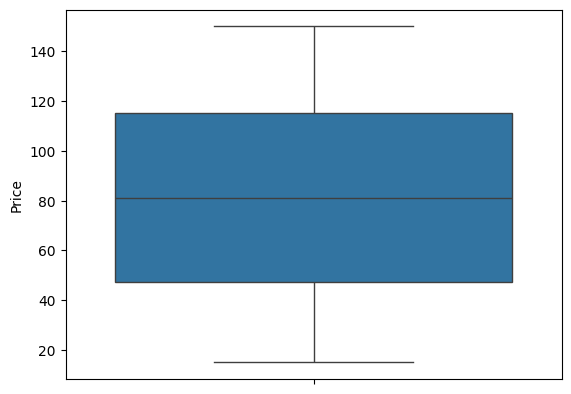

In [29]:
sns.boxplot(df['Price'])
plt.show()

c:\Users\USER\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\categorical.py:632: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)


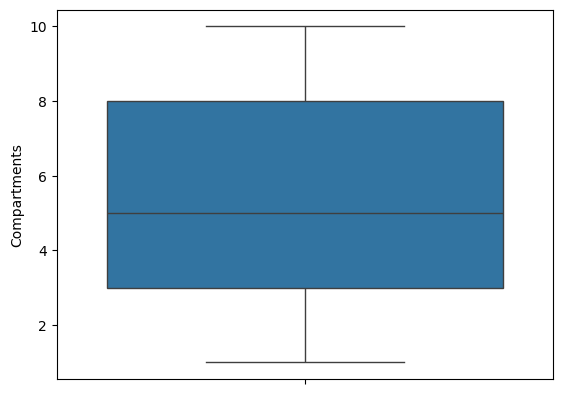

In [30]:
sns.boxplot(df['Compartments'])
plt.show()

c:\Users\USER\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\categorical.py:632: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)


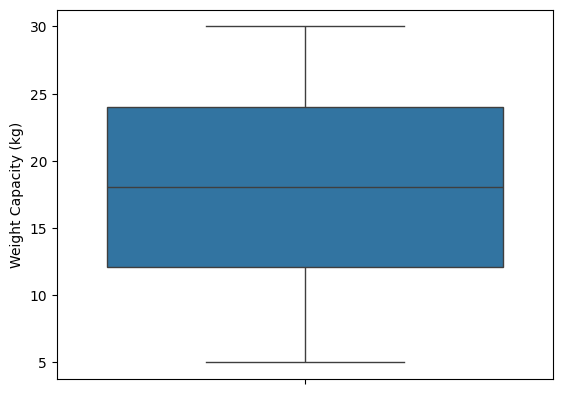

In [31]:
sns.boxplot(df['Weight Capacity (kg)'])
plt.show()

## Exploratory Data Analysis

### Univariate Analysis

#### 1. Categorical

In [32]:
numeric = df.select_dtypes(include='number').columns.tolist()[1:]
categorical = df.select_dtypes(include='object').columns.tolist()
print("Numerical columns : ",numeric)
print("categorical columns :",categorical)

Numerical columns :  ['Compartments', 'Weight Capacity (kg)', 'Price']
categorical columns : ['Brand', 'Material', 'Size', 'Laptop Compartment', 'Waterproof', 'Style', 'Color']


In [33]:
def univ_cat(df, col):
    fig = make_subplots(rows=1, cols=2, specs=[[{'type':'histogram'}, {'type':'pie'}]], subplot_titles=['Histogram', 'Pie'])
    fig.add_trace(go.Histogram(x=df[col]), 1, 1)
    fig.add_trace(go.Pie(labels=df[col].value_counts().index, values=df[col].value_counts(), textinfo='label+percent'), 1, 2)
    fig.update_layout( title_text=f'{col}')
    fig.update_traces(showlegend=False)
    fig.show()

In [34]:
for column in categorical:
    univ_cat(df,column)

#### 2. Numerical 

In [35]:
print(df[numeric].describe())

        Compartments  Weight Capacity (kg)          Price
count  300000.000000         300000.000000  300000.000000
mean        5.443590             18.029994      81.411107
std         2.890766              6.965312      39.039340
min         1.000000              5.000000      15.000000
25%         3.000000             12.099086      47.384620
50%         5.000000             18.064618      80.956120
75%         8.000000             24.001145     115.018160
max        10.000000             30.000000     150.000000


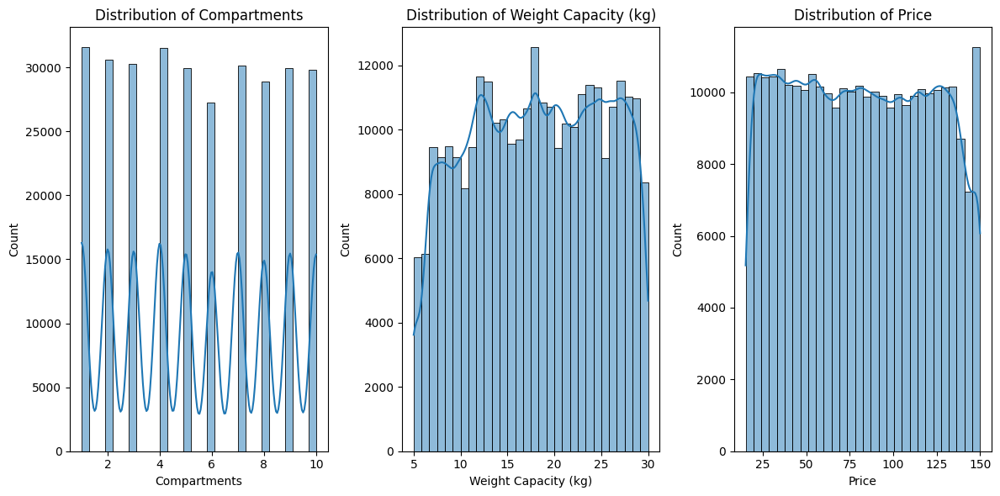

In [36]:
plt.figure(figsize=(12, 6))
for i, col in enumerate(numeric, 1):
    plt.subplot(1, 3, i)
    sns.histplot(df[col], kde=True, bins=30)
    plt.title(f"Distribution of {col}")
plt.tight_layout()
plt.show()


This shows 
1. compartments are discrete
2. Weight Capacity and Price are Uniformly distributed 

### Bivariate Analysis

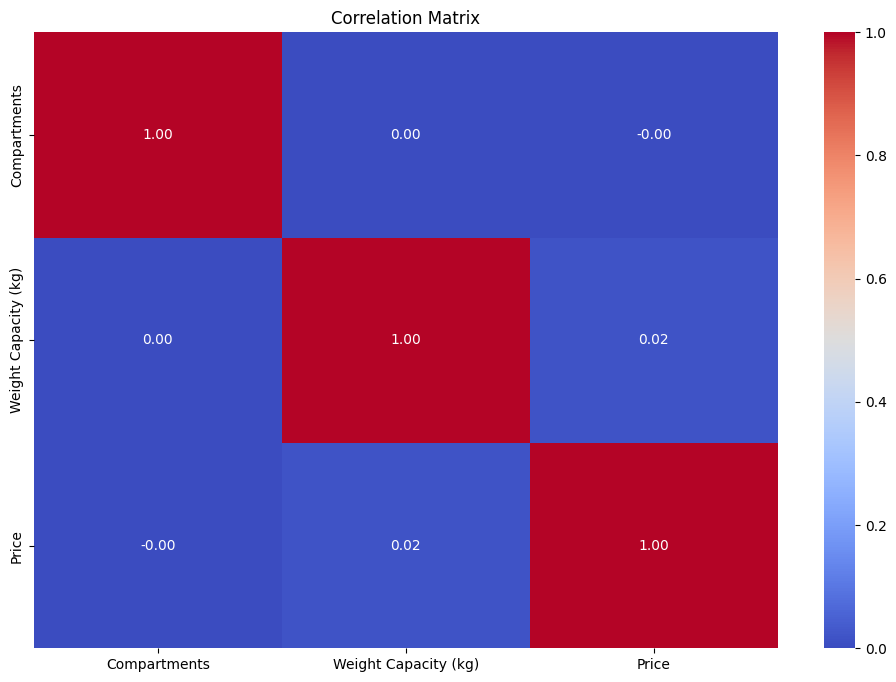

In [37]:
correlation_matrix = df[numeric].corr()
plt.figure(figsize=(12,8))

sns.heatmap(correlation_matrix,annot = True, fmt = '.2f',cmap = 'coolwarm')
plt.title("Correlation Matrix")
plt.show()

This shows weak or no relationship as all correlation values is  < 0.2 

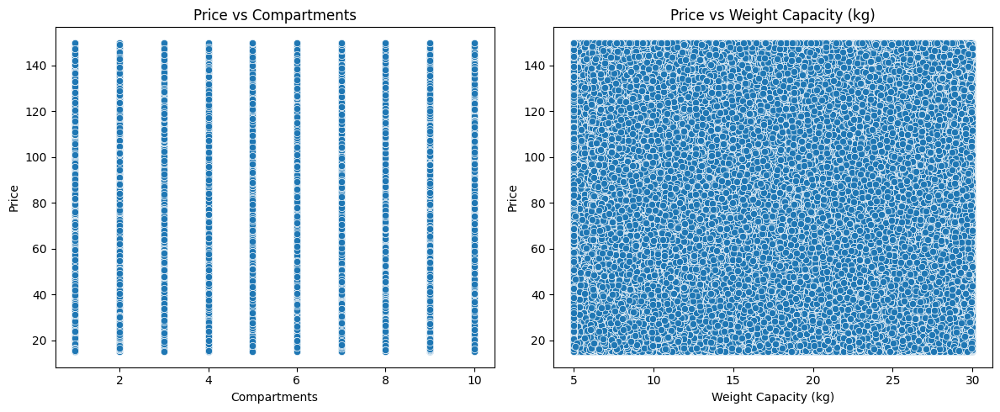

In [36]:
plt.figure(figsize=(12, 5))
for i, col in enumerate(numeric[:-1], 1):
    plt.subplot(1, 2, i)
    sns.scatterplot(x=df[col], y=df["Price"])
    plt.title(f"Price vs {col}")
plt.tight_layout()
plt.show()

c:\Users\USER\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\categorical.py:632: FutureWarning:

SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.



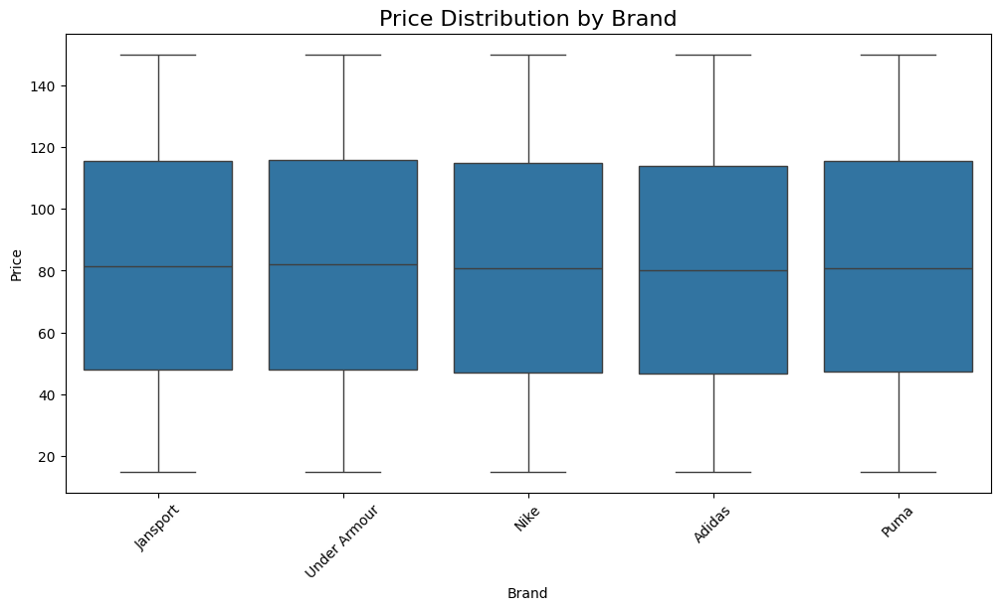

c:\Users\USER\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\categorical.py:632: FutureWarning:

SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.



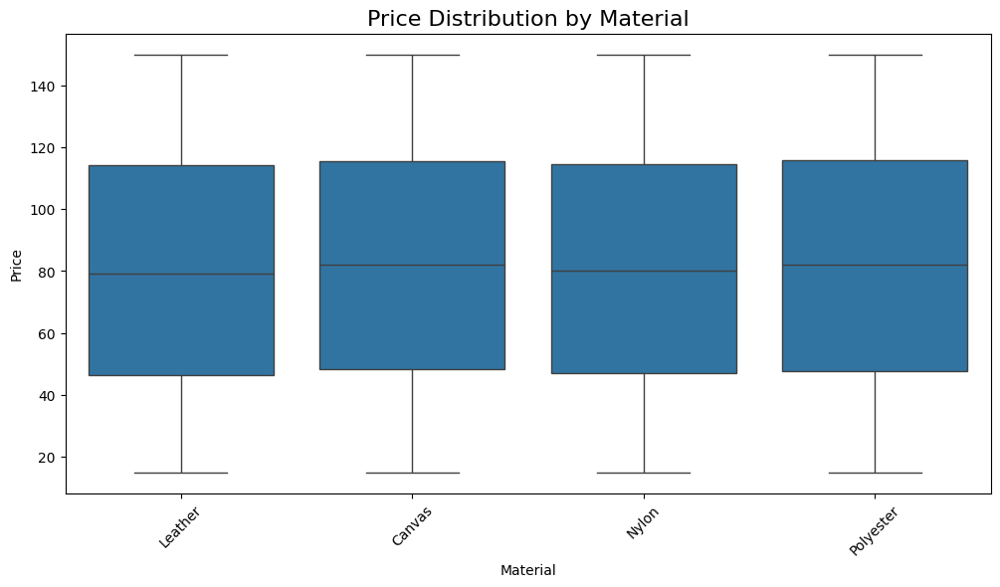

c:\Users\USER\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\categorical.py:632: FutureWarning:

SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.



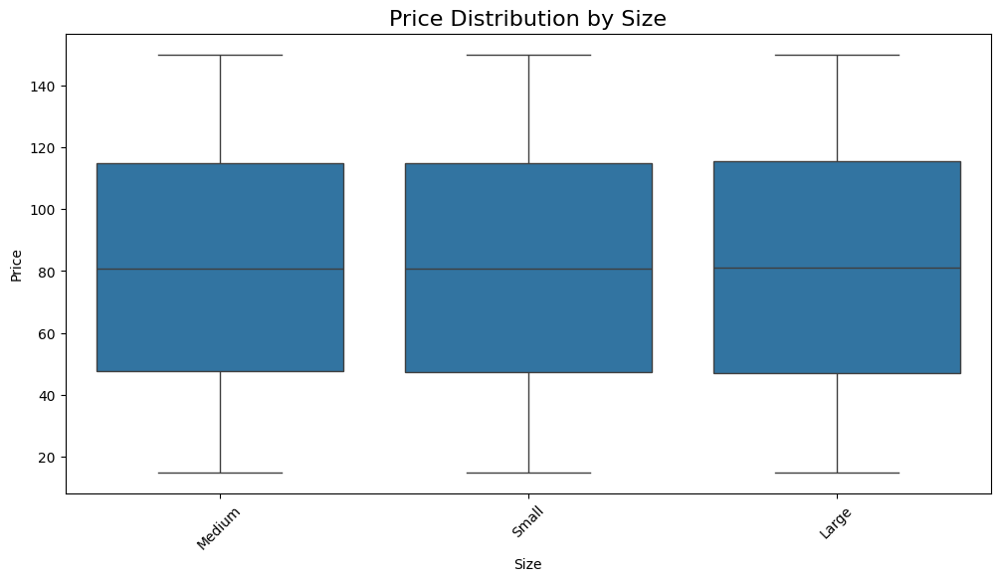

c:\Users\USER\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\categorical.py:632: FutureWarning:

SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.



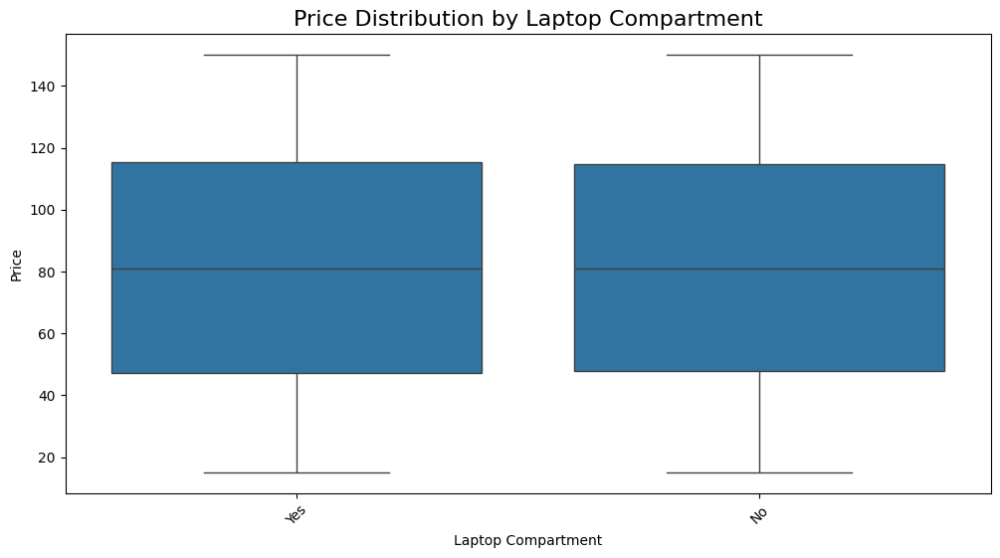

c:\Users\USER\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\categorical.py:632: FutureWarning:

SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.



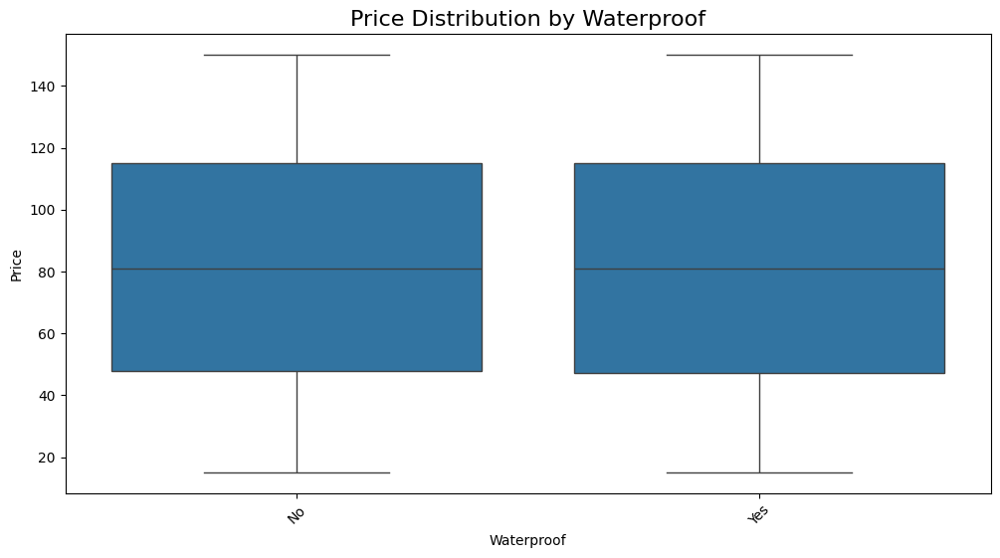

c:\Users\USER\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\categorical.py:632: FutureWarning:

SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.



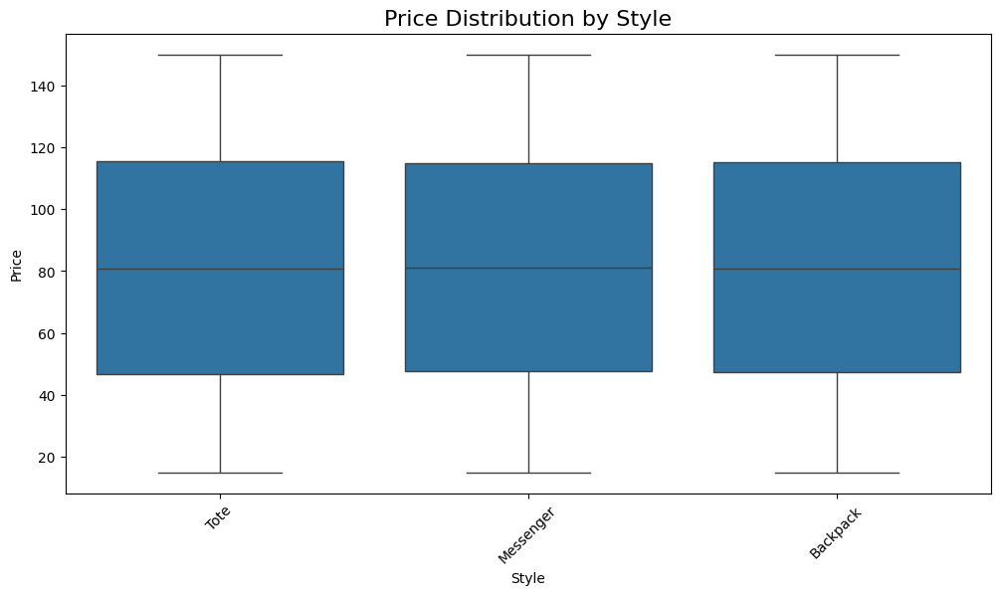

c:\Users\USER\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\categorical.py:632: FutureWarning:

SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.



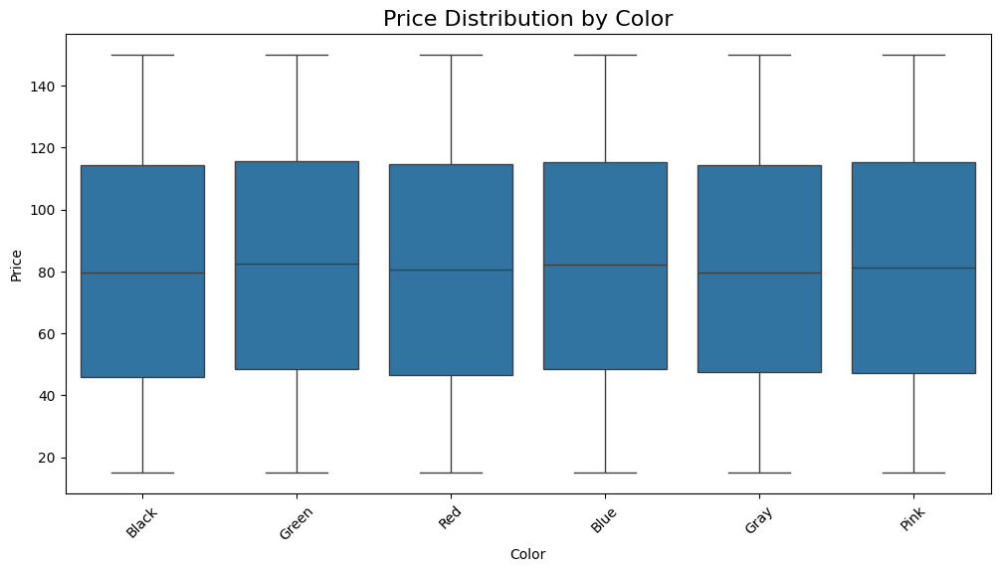

In [37]:
for col in categorical:
    plt.figure(figsize=(12, 6))
    sns.boxplot(data=df, x=col, y='Price', hue=None)  
    plt.title(f'Price Distribution by {col}', fontsize=16)
    plt.xticks(rotation=45)
    plt.show()


In [38]:

for col in categorical:
    group_stats = df.groupby(col)['Price'].agg(['mean', 'median', 'std']).sort_values(by='mean', ascending=False)
    print(f"\nStatistics for {col}:\n", group_stats)



Statistics for Brand:
                    mean     median        std
Brand                                        
Under Armour  81.925876  81.945905  38.978157
Jansport      81.737736  81.354970  38.984596
Puma          81.475843  80.716730  39.232099
Nike          81.315482  80.654430  39.143939
Adidas        80.621061  80.031465  38.856585

Statistics for Material:
                 mean     median        std
Material                                  
Canvas     82.084367  82.090730  39.008406
Polyester  82.054361  81.993275  39.090425
Nylon      81.031465  80.273550  38.924280
Leather    80.455456  79.187670  39.099094

Statistics for Size:
              mean     median        std
Size                                   
Large   81.567794  81.153340  39.354759
Small   81.366167  80.783565  39.029884
Medium  81.300354  80.898910  38.739975

Statistics for Laptop Compartment:
                          mean    median        std
Laptop Compartment                                
No     

#### Inferences from statistics:
1. Under Armour brand has highest mean - 81.922844.There is price consistency among the brands
2. Canvas and polyester has high mean prices. Leather’s lower mean and high standard deviation could indicate a wider variety in quality and pricing tiers. 
3. The mean price is proportional to size 
4. Laptop compartment might be standard in most bags since there isn't much mean price difference. 
5. Bags without waterproof might have styles and designs
6. Messenger styled bags have higher mean.
7. Green,Blue bags have high mean prices - could be professional
8. Red has high std deviation so it might have high vareity and designs with wider price range 
9. Gray and Black has lower mean. 

C:\Users\USER\AppData\Local\Temp\ipykernel_15432\557288870.py:3: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




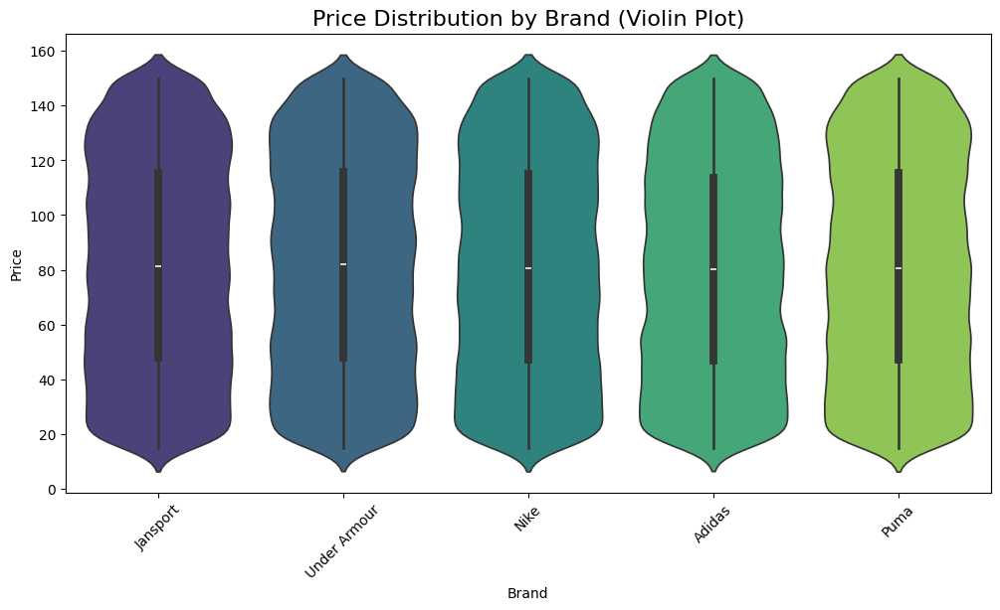

C:\Users\USER\AppData\Local\Temp\ipykernel_15432\557288870.py:3: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




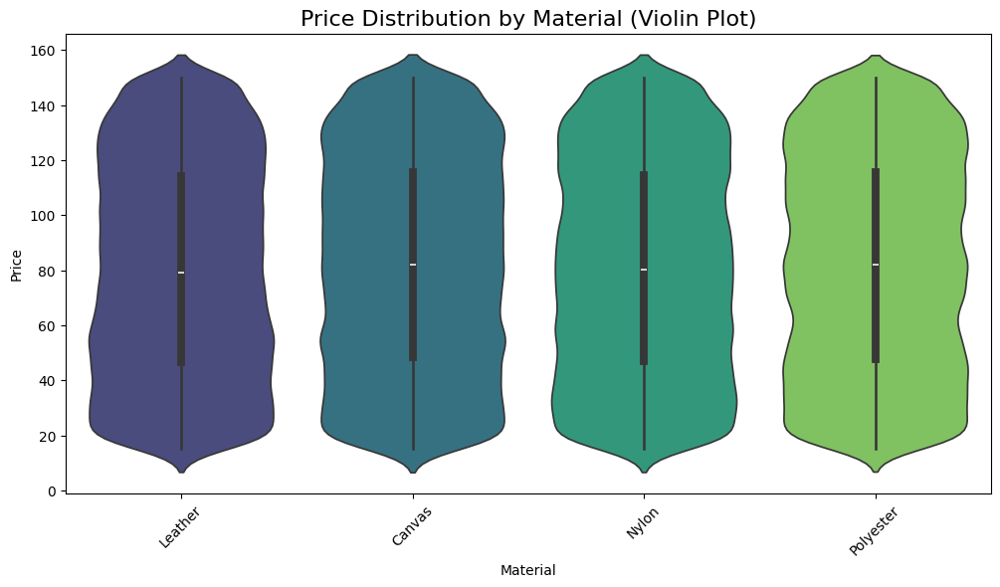

C:\Users\USER\AppData\Local\Temp\ipykernel_15432\557288870.py:3: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




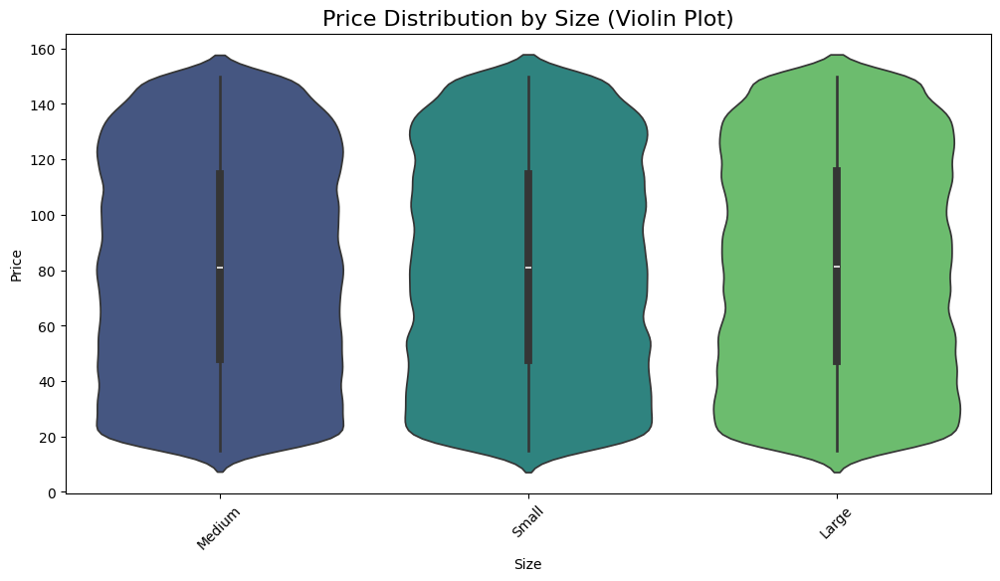

C:\Users\USER\AppData\Local\Temp\ipykernel_15432\557288870.py:3: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




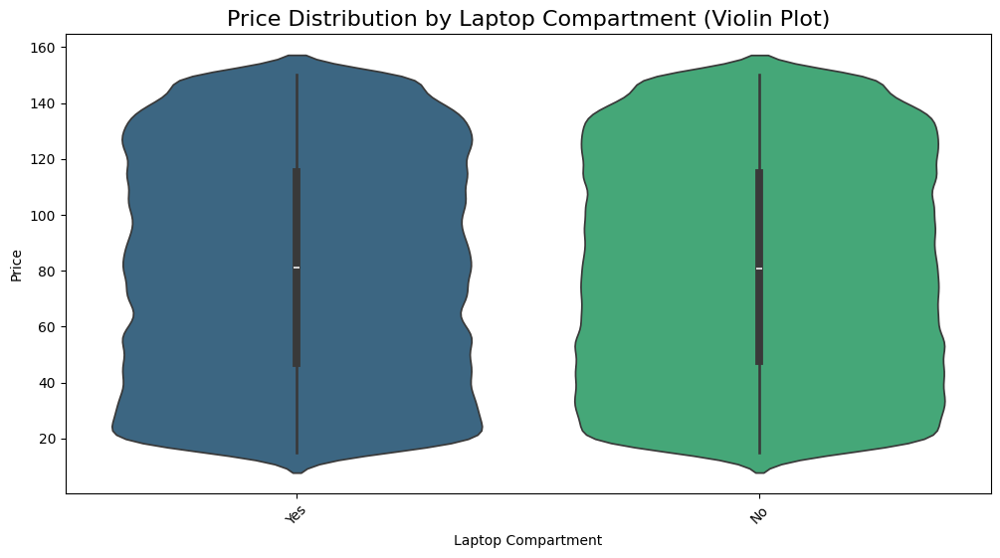

C:\Users\USER\AppData\Local\Temp\ipykernel_15432\557288870.py:3: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




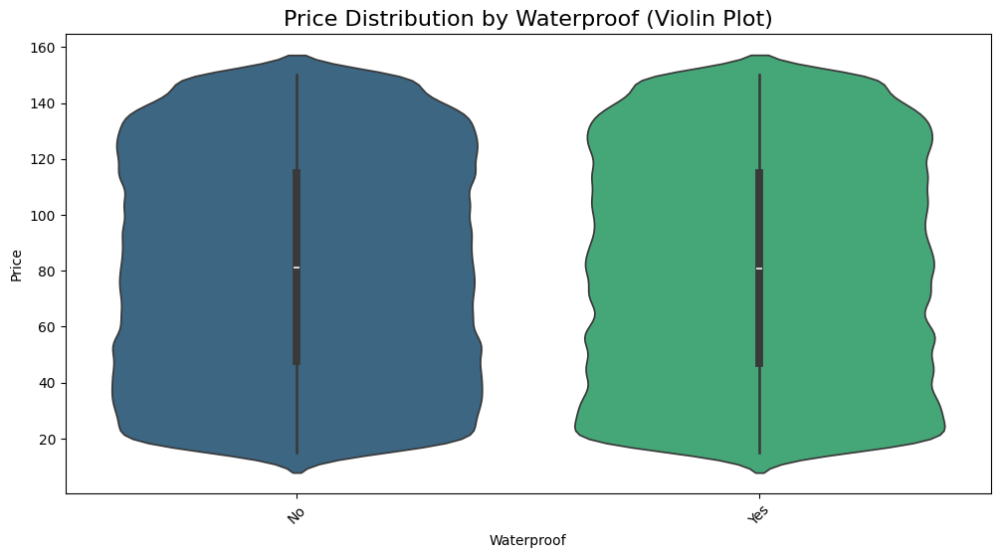

C:\Users\USER\AppData\Local\Temp\ipykernel_15432\557288870.py:3: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




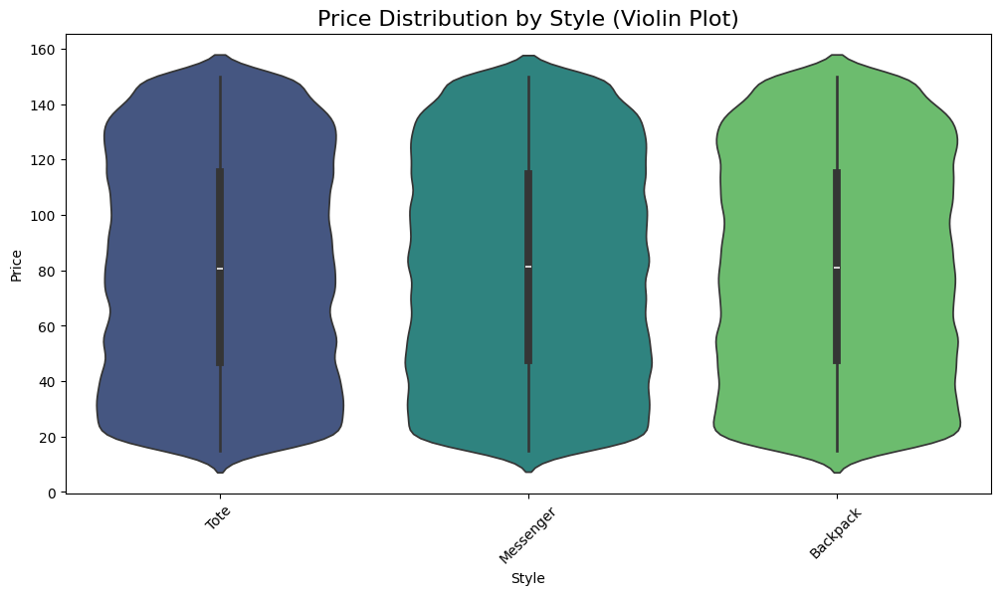

C:\Users\USER\AppData\Local\Temp\ipykernel_15432\557288870.py:3: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




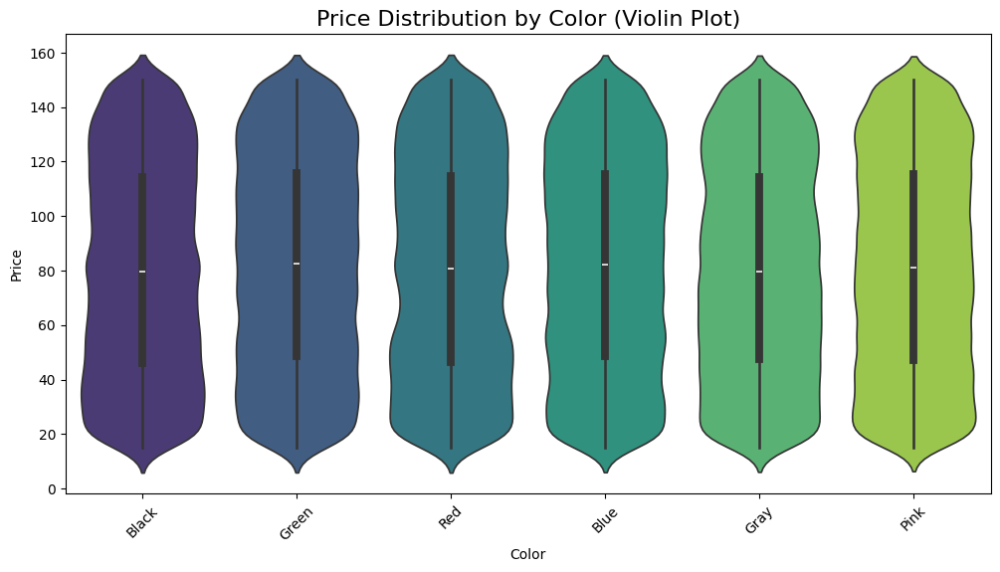

In [39]:

for col in categorical:
    plt.figure(figsize=(12, 6))
    sns.violinplot(data=df, x=col, y='Price', palette='viridis',hue = None)
    plt.title(f'Price Distribution by {col} (Violin Plot)', fontsize=16)
    plt.xticks(rotation=45)
    plt.show()


## Feature Engineering

In [40]:
#df['Price_to_compartment'] = df['Price']/df['Compartments']

In [41]:
df['weight_to_compartment'] = df['Weight Capacity (kg)'] / df['Compartments']

In [42]:
df['Price'].describe()

count    300000.000000
mean         81.411107
std          39.039340
min          15.000000
25%          47.384620
50%          80.956120
75%         115.018160
max         150.000000
Name: Price, dtype: float64

Using quantile binning for Price

In [ ]:
#df['Price_bin'] = pd.qcut(df['Price'], q=5, labels=False)
#df['Price_bin'].value_counts().sort_index()

In [43]:
print(df['Weight Capacity (kg)'].describe())

count    300000.000000
mean         18.029994
std           6.965312
min           5.000000
25%          12.099086
50%          18.064618
75%          24.001145
max          30.000000
Name: Weight Capacity (kg), dtype: float64


Using quantile binning for Weight capacity

In [44]:
df['weight_bin'] = pd.qcut(df['Weight Capacity (kg)'], q=5, labels=False)
print(df['weight_bin'].value_counts().sort_index()) 

weight_bin
0    60000
1    60000
2    60000
3    60000
4    60000
Name: count, dtype: int64


In [ ]:

#weight_price_stats = df.groupby('weight_bin')['Price'].agg(['mean', 'median', 'std', 'count'])
#print(weight_price_stats)


In [ ]:
#df['Price_per_kg'] = df['Price'] / df['Weight Capacity (kg)']

In [45]:
df = pd.get_dummies(df, columns=['Brand', 'Material', 'Style', 'Color','Waterproof','Laptop Compartment'], drop_first=True)

In [46]:
size_mapping = {'Small': 0, 'Medium': 1, 'Large': 2}
df['Size'] = df['Size'].map(size_mapping)


In [47]:
df.columns

Index(['id', 'Size', 'Compartments', 'Weight Capacity (kg)', 'Price',
       'weight_to_compartment', 'weight_bin', 'Brand_Jansport', 'Brand_Nike',
       'Brand_Puma', 'Brand_Under Armour', 'Material_Leather',
       'Material_Nylon', 'Material_Polyester', 'Style_Messenger', 'Style_Tote',
       'Color_Blue', 'Color_Gray', 'Color_Green', 'Color_Pink', 'Color_Red',
       'Waterproof_Yes', 'Laptop Compartment_Yes'],
      dtype='object')

In [48]:
scaler = StandardScaler()  # or MinMaxScaler()
df[['Price', 'Weight Capacity (kg)','Compartments','weight_to_compartment',]] = scaler.fit_transform(
    df[['Price', 'Weight Capacity (kg)', 'Compartments','weight_to_compartment',]])

In [ ]:
df.to_csv("cleaned_train.csv", index=False)

In [49]:
df_copy = df.drop(columns=['id'])

In [50]:
df.columns

Index(['id', 'Size', 'Compartments', 'Weight Capacity (kg)', 'Price',
       'weight_to_compartment', 'weight_bin', 'Brand_Jansport', 'Brand_Nike',
       'Brand_Puma', 'Brand_Under Armour', 'Material_Leather',
       'Material_Nylon', 'Material_Polyester', 'Style_Messenger', 'Style_Tote',
       'Color_Blue', 'Color_Gray', 'Color_Green', 'Color_Pink', 'Color_Red',
       'Waterproof_Yes', 'Laptop Compartment_Yes'],
      dtype='object')

Splitting the dataset

In [55]:
X = df_copy.drop(columns=['Price'])
y = df_copy['Price']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

Model Training -  Linear Regression

In [56]:
model_LinearRegression = LinearRegression()
model_LinearRegression.fit(X_train,y_train)

LinearRegression()

In [184]:
model_LinearRegression = LinearRegression()
model_LinearRegression.fit(X,y)

LinearRegression()

In [187]:
df_test = pd.read_csv("cleaned_test.csv")
df_test.head()

,id,Size,Compartments,Weight Capacity (kg),weight_to_compartment,weight_bin,Brand_Jansport,Brand_Nike,Brand_Puma,Brand_Under Armour,Material_Leather,Material_Nylon,Material_Polyester,Style_Messenger,Style_Tote,Color_Blue,Color_Gray,Color_Green,Color_Pink,Color_Red,Waterproof_Yes,Laptop Compartment_Yes
0,300000,0,-1.191822,0.384195,0.889991,3,False,False,True,False,True,False,False,False,True,False,False,True,False,False,False,False
1,300001,1,0.539041,-0.635362,-0.616352,1,False,True,False,False,False,False,False,False,False,False,False,True,False,False,True,False
2,300002,2,1.231386,-0.887030,-0.728555,1,False,False,False,False,False,False,False,True,False,True,False,False,False,False,True,False
3,300003,2,-1.537995,0.069434,2.350346,2,False,False,False,False,False,True,False,True,False,False,False,True,False,False,False,True
4,300004,2,-1.191822,-1.159863,-0.075320,0,False,True,False,False,False,True,False,False,True,False,False,False,False,False,True,True


In [188]:
df_test = df_test.drop(columns = ['id'])

In [57]:
y_pred = model_LinearRegression.predict(X_test)

In [191]:
df_test['Predicted_Price'] = y_pred
df_test.to_csv("test_predictions.csv", index=False)
print("Predictions saved to test_predictions.csv")

Predictions saved to test_predictions.csv


In [58]:
print("MAE:", mean_absolute_error(y_test, y_pred))
print("MSE:", mean_squared_error(y_test, y_pred))
print("R² Score:", r2_score(y_test, y_pred))
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print("RMSE:", rmse)

MAE: 0.862895017375118
MSE: 0.9936785433645617
R² Score: 0.0013167023445130877
RMSE: 0.9968342607297171


####  Random forest Regressor

In [ ]:


# Initialize model
rf_model = RandomForestRegressor(n_estimators=100, random_state=42)

# Train model
rf_model.fit(X_train, y_train)

# Predict on test set
y_pred_rf = rf_model.predict(X_test)

# Evaluate performance
print("Random Forest RMSE:", np.sqrt(mean_squared_error(y_test, y_pred_rf)))


Random Forest RMSE: 1.0312525868890818


In [62]:
for n in [50, 100, 200, 500]:  
    model = RandomForestRegressor(n_estimators=n, random_state=42)
    scores = cross_val_score(model, X_train, y_train, cv=5, scoring="neg_root_mean_squared_error")
    print(f"n_estimators={n}, RMSE={-scores.mean()}")


n_estimators=50, RMSE=1.0397227894244925
n_estimators=100, RMSE=1.034831156487797
n_estimators=200, RMSE=1.0321422683408836
n_estimators=500, RMSE=1.030567627729206


In [66]:
import pyopencl as cl

platforms = cl.get_platforms()
for platform in platforms:
    print(f"Platform: {platform.name}")
    for device in platform.get_devices():
        print(f"  Device: {device.name} - Type: {cl.device_type.to_string(device.type)}")


Platform: Intel(R) OpenCL HD Graphics
  Device: Intel(R) HD Graphics 520 - Type: ALL | GPU
Platform: AMD Accelerated Parallel Processing
  Device: Hainan - Type: ALL | GPU


In [67]:
import pyopencl as cl

# Get all OpenCL platforms
platforms = cl.get_platforms()

# Find AMD platform
amd_platform = None
for platform in platforms:
    if "AMD" in platform.name:
        amd_platform = platform
        break

if amd_platform:
    device = amd_platform.get_devices()[0]  # Select first AMD device
    ctx = cl.Context([device])
    queue = cl.CommandQueue(ctx)
    print(f"Using GPU: {device.name}")
else:
    print("AMD GPU not found!")


Using GPU: Hainan


In [70]:
params = {
    "booster": "gbtree",
    "n_estimators": 200,      # More trees for better learning
    "learning_rate": 0.05,    # Lower learning rate for better accuracy
    "max_depth": 7,           # Increase depth for capturing more patterns
    "min_child_weight": 3,    # Helps prevent overfitting
    "gamma": 0.1,             # Controls splitting
    "subsample": 0.8,         # Use 80% of data per tree
    "colsample_bytree": 0.8,  # Use 80% of features per tree
    "reg_alpha": 0.1,         # Some L1 regularization
    "reg_lambda": 1.0,        # Default L2 regularization
    "tree_method": "hist",   # Use GPU for training
    "predictor": "gpu_predictor" # Use GPU for predictions
}

model = xgb.XGBRegressor(**params)
model.fit(X_train, y_train)


c:\Users\USER\AppData\Local\Programs\Python\Python311\Lib\site-packages\xgboost\core.py:158: UserWarning:

[09:36:00] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-08cbc0333d8d4aae1-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "predictor" } are not used.




: 

In [ ]:


# Define model parameters
params = {
    "boosting_type": "gbdt",
    "objective": "regression",
    "metric": "rmse",
    "learning_rate": 0.05,
    "num_leaves": 31,
    "max_depth": -1,
    "subsample": 0.8,
    "colsample_bytree": 0.8,
    "device": "gpu"  # ✅ Enable GPU (AMD or NVIDIA)
}

# Train model
train_data = lgb.Dataset(X_train, label=y_train)
valid_data = lgb.Dataset(X_valid, label=y_valid, reference=train_data)

model = lgb.train(params, train_data, valid_sets=[valid_data], verbose_eval=100)

# Predictions
y_pred = model.predict(X_test)
rmse = mean_squared_error(y_test, y_pred, squared=False)
print("RMSE:", rmse)
